In [35]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import mapclassify as mc

### Crime index

In [3]:
crime_idx = gpd.read_file("../data/processed/poa_crime_index.geojson")
crime_idx.shape

(9001, 14)

In [4]:
crime_idx.head()

,Year,Local Government Area,Postcode,Total Incidents,POA_CODE16,POA_NAME16,AREASQKM16,Total Households,Population,"Incidents by 10,000 households","Incidents by 10,000 population",Incidents by 1000 households,Incidents by 1000 population,geometry
0,2011,Alpine,3691,5,3691,3691,1837.4123,2550,9600,1.960016,0.520779,1.960016,0.520779,"MULTIPOLYGON (((146.90262 -36.10540, 146.90189..."
1,2011,Alpine,3697,4,3697,3697,140.6154,158,541,25.157233,7.380074,25.157233,7.380074,"POLYGON ((147.13594 -36.69941, 147.13629 -36.6..."
2,2011,Alpine,3698,3,3698,3698,48.8349,234,936,12.765957,3.201708,12.765957,3.201708,"POLYGON ((147.13954 -36.72241, 147.14057 -36.7..."
3,2011,Alpine,3699,13,3699,3699,502.9748,225,4169,57.522124,3.117506,57.522124,3.117506,"POLYGON ((147.16186 -36.73468, 147.16187 -36.7..."
4,2011,Alpine,3737,153,3737,3737,1737.5617,1145,4136,133.507853,36.983321,133.507853,36.983321,"POLYGON ((146.65912 -36.54841, 146.65910 -36.5..."


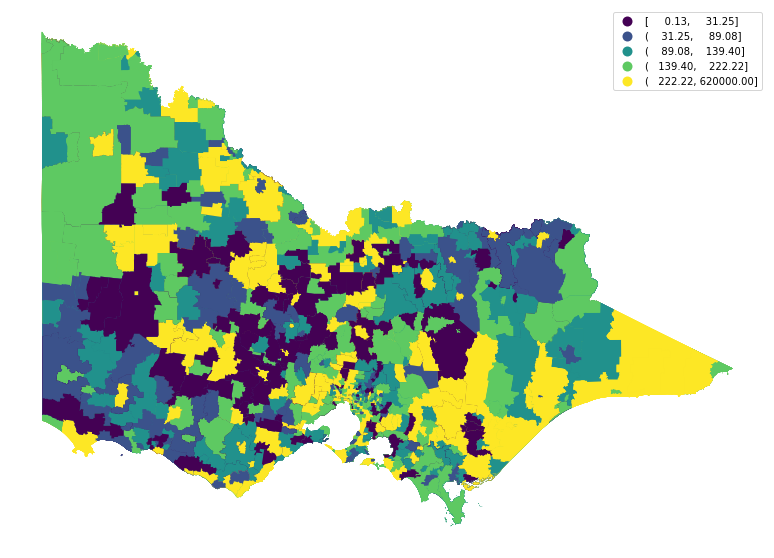

In [42]:
ax = crime_idx.plot(figsize=(15,10), column="Incidents by 1000 households", 
                    scheme='quantiles', legend=True)
ax.set_axis_off()

### Using mapclassify

In [36]:
mc.CLASSIFIERS

('BoxPlot',
 'EqualInterval',
 'FisherJenks',
 'FisherJenksSampled',
 'HeadTailBreaks',
 'JenksCaspall',
 'JenksCaspallForced',
 'JenksCaspallSampled',
 'MaxP',
 'MaximumBreaks',
 'NaturalBreaks',
 'Quantiles',
 'Percentiles',
 'StdMean',
 'UserDefined')

In [37]:
y = crime_idx["Incidents by 10,000 population"]
ea5 = mc.EqualInterval(y, k=5)
ea5

EqualInterval                 

       Interval          Count
------------------------------
[     0.03,  47800.03] |  8991
( 47800.03,  95600.02] |     0
( 95600.02, 143400.01] |     0
(143400.01, 191200.01] |     6
(191200.01, 239000.00] |     4

In [38]:
bp = mc.BoxPlot(y)
bp

BoxPlot                       

       Interval          Count
------------------------------
(     -inf,    -44.97] |     0
(   -44.97,     12.99] |  2251
(    12.99,     30.73] |  2250
(    30.73,     51.62] |  2250
(    51.62,    109.58] |  1843
(   109.58, 239000.00] |   407

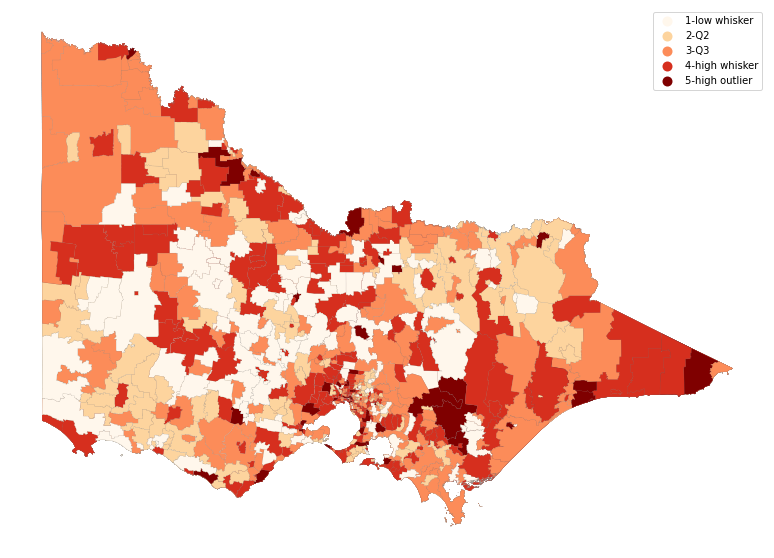

In [41]:
labels = ['0-low outlier', '1-low whisker',
          '2-Q2', '3-Q3', '4-high whisker', '5-high outlier']
bpl = [ labels[b] for b in bp.yb ]

f, ax = plt.subplots(1, figsize=(15,10))
crime_idx.assign(cl=bpl).plot(column='cl', categorical=True, \
                                      k=4, cmap='OrRd', linewidth=0.1, ax=ax,\
                                      edgecolor='grey', legend=True)
ax.set_axis_off()
plt.show()


### Postcode shapefile

In [14]:
poa_gdf = gpd.read_file("../data/processed/vic_poa_shapefile.geojson")

/home/danph/anaconda3/envs/pysal-workshop/lib/python3.7/site-packages/ipykernel_launcher.py:2: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  


<AxesSubplot:>

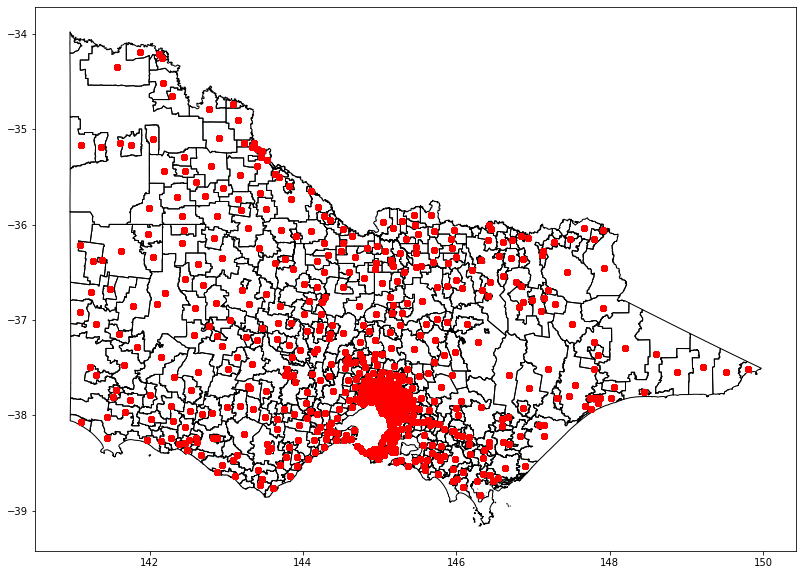

In [18]:
ax = poa_gdf.plot(edgecolor='k', facecolor='none', figsize=(15,10))
crime_idx.geometry.centroid.plot(ax=ax, color='red')

### Interactive web-based visualizations

In [16]:
import folium

In [40]:
m = folium.Map([-37.8141, 144.9619], zoom_start=8, tiles="OpenStreetMap")
folium.GeoJson(poa_gdf.to_json()).add_to(m)
m